In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mp_patches  # For circles and rectangles

# Load Data
`pos`, `imu`

In [ ]:
run = '041021_triangle_1_pos_imu'
t0 = 1633351104.397583  # Time corresponding to t=0 in pos.csv
url = 'https://drive.google.com/file/d/1sMmyxhtGGNpuuR2PQzPcH4_isJEGBVjf/view?usp=sharing'

In [ ]:
!ls '{run}.tar.xz' 2>/dev/null || (python -m pip install gdown --upgrade > /dev/null && gdown --fuzzy  '{url}' )

Downloading...
From: https://drive.google.com/uc?id=1sMmyxhtGGNpuuR2PQzPcH4_isJEGBVjf
To: /content/041021_triangle_1_pos_imu.tar.xz
100% 204k/204k [00:00<00:00, 72.8MB/s]


In [ ]:
!ls '{run}' 2>/dev/null 1>/dev/null || tar xvf '{run}.tar.xz'

041021_triangle_1_pos_imu/
041021_triangle_1_pos_imu/imu.csv
041021_triangle_1_pos_imu/pos.csv


imu.csv is not zero corrected.
position_data_zc.csv starts at zero

In [ ]:
pos_orig = np.loadtxt(f'{run}/pos.csv', delimiter=', ')

In [ ]:
imu_orig = np.loadtxt(f'{run}/imu.csv', delimiter=',', skiprows=1)
imu_orig[:, 0] -= t0

In [ ]:
t_start = 0
t_end = min(pos_orig[-1, 0], imu_orig[-1, 0])
t_end - t_start

204.81935048103333

In [ ]:
pos = pos_orig[(pos_orig[:, 0] >= t_start) & (pos_orig[:, 0] <= t_end), :]
imu = imu_orig[(imu_orig[:, 0] >= t_start) & (imu_orig[:, 0] <= t_end), :]
pos.flags.writeable = False
imu.flags.writeable = False
pos.shape, pos_orig.shape, imu.shape, imu_orig.shape

((123, 3), (139, 3), (8193, 7), (8394, 7))

In [ ]:
pos = pos_orig[(pos_orig[:, 0] >= t_start) & (pos_orig[:, 0] <= t_end), :]

In [ ]:
L = 8.8
W = 3.0
path = [4.7, 2.68], [0, 1.6], [4.7, 0.42], [4.7, 2.68]
fs=40
dt = 1.0/fs

## Keep `pos` inside of the pool

In [ ]:
pos.shape

(123, 3)

In [ ]:
pos = pos[(pos[:,1] >= 0) & (pos[:,1] <= 6) & (pos[:,2] >= 0) & (pos[:,2] <= W)]

In [ ]:
pos.shape

(120, 3)

# Position and IMU Plot

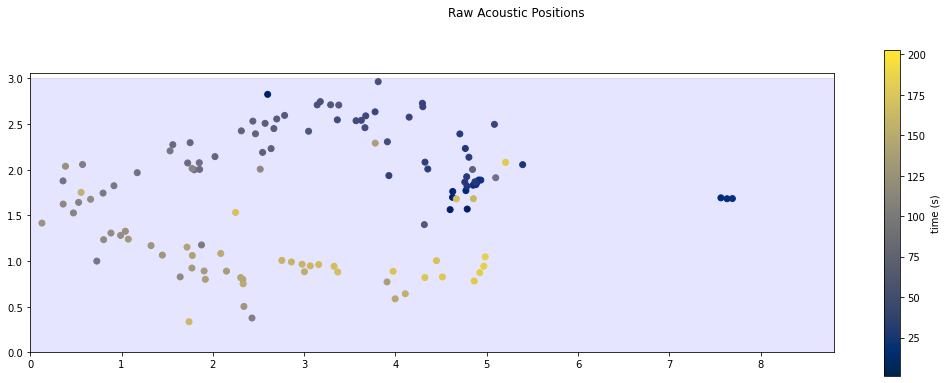

[1.420939   4.78617748 1.56993293] [3.468946   4.59899625 1.56390928]


In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

ax.set_aspect('equal', 'box')

ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='blue'))
# ax.scatter(h_locs[:, 0], h_locs[:, 1])
ax.plot(*zip(path), label="Ground Truth")

# ax.set_xlim(*ax.get_xlim())
# ax.set_ylim(*ax.get_ylim())

ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)

plt.scatter(*pos[:,1:3].T, c=pos[:, 0], cmap='cividis')
plt.colorbar(label='time (s)')
plt.suptitle('Raw Acoustic Positions')
plt.show()
print(pos[0], pos[1])

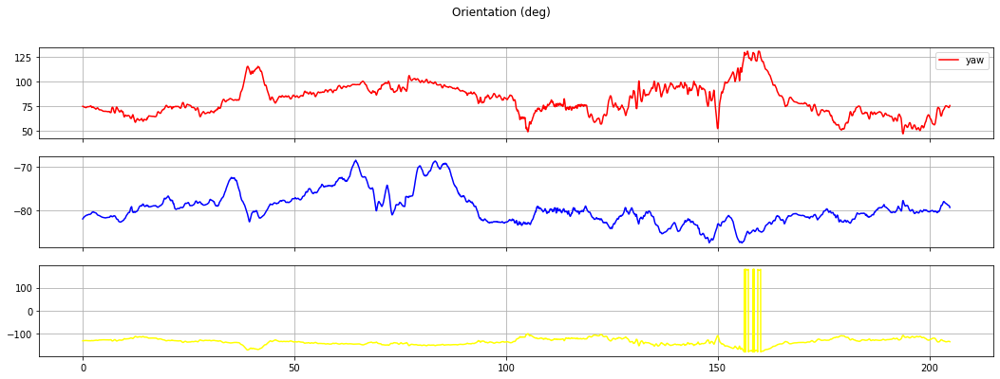

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)
ax[0].plot(imu[:,0], imu[:,1], label='yaw', color='red')
ax[0].legend()
ax[1].plot(imu[:,0], imu[:,2], color='blue', label='pitch')
ax[0].legend()
ax[2].plot(imu[:,0], imu[:,3], color='yellow', label='roll')
for a in ax:
    a.grid()
fig.suptitle("Orientation (deg)");

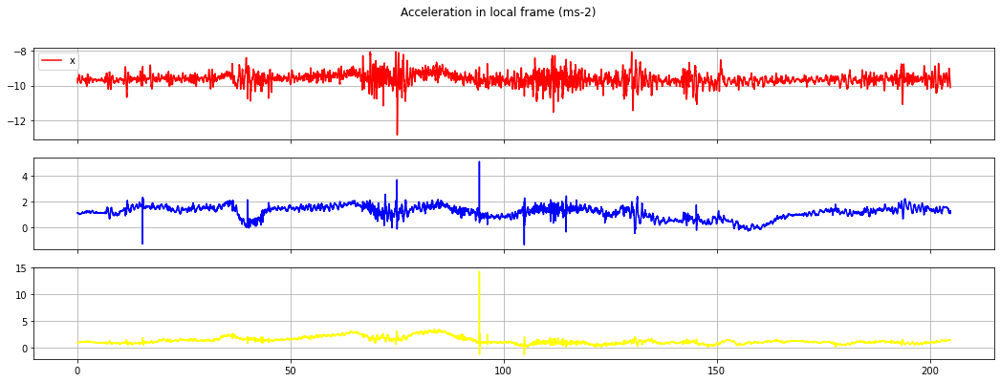

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

acc = imu[:, 4:7] #- imu[:, 4:7].mean(axis=0)

ax[0].plot(imu[:,0], acc[:,0], label='x', color='red')
ax[0].legend()
ax[1].plot(imu[:,0], acc[:,1], color='blue', label='y')
ax[0].legend()
ax[2].plot(imu[:,0], acc[:,2], color='yellow', label='y')
for a in ax:
    a.grid()

fig.suptitle("Acceleration in local frame (ms-2)");

In [ ]:
def clip_perc(data, lo=1, hi=99):
    return np.clip(data, np.percentile(data, lo), np.percentile(data, hi))

## Get Global Acceleration

In [ ]:
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)
R = R1 @ R2 @ R3

In [ ]:
R.shape, np.allclose(np.linalg.det(R), 1) 

((8193, 3, 3), True)

In [ ]:
imu[:, 4:7].reshape(-1, 3, 1)[0]

array([[-9.845],
       [ 1.128],
       [ 0.91 ]])

In [ ]:
acc = (R @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)

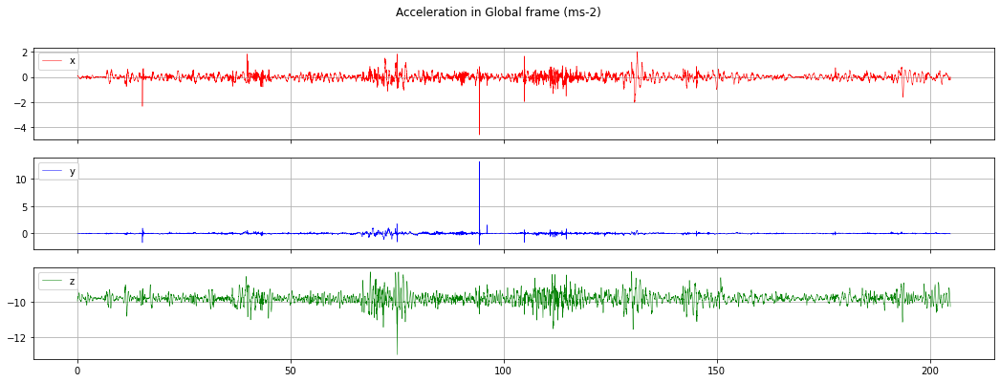

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], acc[:,0], label='x', linewidth=0.5, color='red')
ax[1].plot(imu[:,0], acc[:,1], label='y', linewidth=0.5, color='blue')
ax[2].plot(imu[:,0], acc[:,2], label='z', linewidth=0.5, color='green')

for a in ax:
    a.legend(loc='upper left')
    a.grid()

fig.suptitle("Acceleration in Global frame (ms-2)");

In [ ]:
def clip_perc(data, lo=1, hi=99):
    return np.clip(data, np.percentile(data, lo), np.percentile(data, hi))

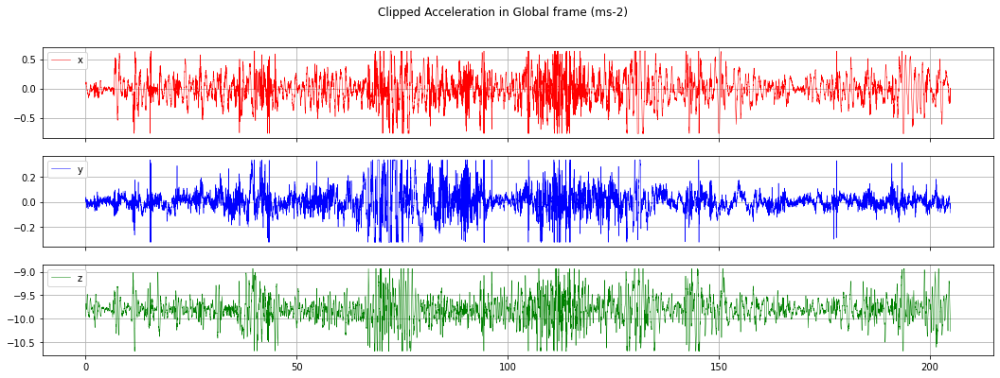

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], clip_perc(acc[:,0]), label='x', linewidth=0.5, color='red')
ax[1].plot(imu[:,0], clip_perc(acc[:,1]), label='y', linewidth=0.5, color='blue')
ax[2].plot(imu[:,0], clip_perc(acc[:,2]), label='z', linewidth=0.5, color='green')

for a in ax:
    a.legend(loc='upper left')
    a.grid()

fig.suptitle("Clipped Acceleration in Global frame (ms-2)");

# Position Only Kalman Filter

In [ ]:
X = np.array(  # Initial State
    pos[0, 1:3]
).reshape(-1,1)  # np.ndarry[2,1]

P = np.array((  # Initial Cov
    (0.01, 0),
    (0, 0.01)
))  # np.ndarry[2,2]

Q = np.array((  # Process noise
    (0.25, 0),
    (0, 0.25)
))  # np.ndarry[2,2]

R = np.array((  # Measurement Noise
    (2, 0),
    (0, 2)
))  # np.ndarry[2,2]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0),
    (0, 1)
))  # np.ndarry[2,2]

H = np.array((  # Measurement Matrix: y_k = H @ x_k + _v
    (1, 0),
    (0, 1)
))  # np.ndarry[2,2]

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
Ls = [c.copy() for c in pos[1:]]

for i in range(len(Ls)):
    P += Q
    K = P @ H.T @ np.linalg.inv(R)
    X_p = X + K @ (np.array((Ls[0][1:3])).reshape(-1,1) - H @ X)
    P_p = (np.eye(2) - K @ H) @ P.T
    Xs.append(X_p.copy())
    Ps.append(P_p.copy())
    del Ls[0]
    X, P = X_p, P_p
    # print(X.T[0])
    # print(K)

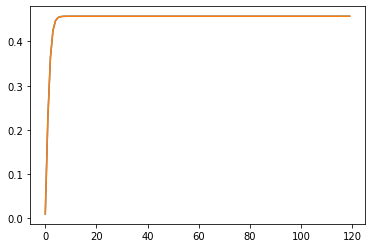

In [ ]:
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

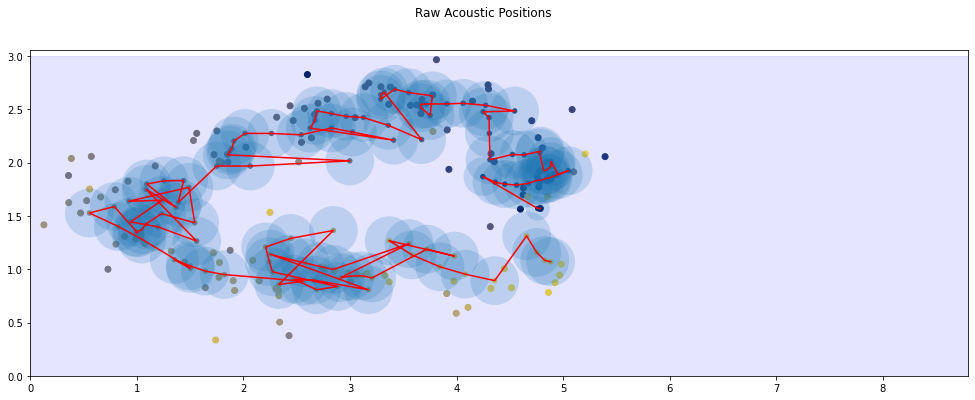

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

ax.set_aspect('equal', 'box')

ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='blue'))
# ax.scatter(h_locs[:, 0], h_locs[:, 1])
# ax.set_xlim(*ax.get_xlim())
# ax.set_ylim(*ax.get_ylim())

ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)

ax.plot(*zip(path), label="Ground Truth")
ax.plot(*zip(*Xs), color='red')

ax.scatter(*pos[:,1:3].T, c=pos[:, 0], cmap='cividis')
ax.scatter(*zip(*Xs), c=pos[:, 0], cmap='cividis', s=20)
for X, P in zip(Xs, Ps):
    # print(P[0,0], P[1,1])
    ax.add_patch(mp_patches.Ellipse(X, P[0,0], P[1,1], alpha=0.2))
# ax.colorbar(label='time (s)')
f.suptitle('Raw Acoustic Positions')
f.show()

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")


from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
def anim_func(frame, ax, loc):
    # print(frame)
    ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
    ret3 = ax.scatter(*Xs[frame][:2, 0], color='red', s=2)
    # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
    global prev
    prev.remove()
    prev = ret1
    # return ret1, ret2, ret3, prev, 
    return ret1, ret3, prev, 

anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
                     frames=len(Xs), interval=5)#, blit=True)

plt.close()

In [ ]:
anim

# Resample imu -- ignore
`imu_sync`

Assume that imu orientation is perfect

In [ ]:
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # acc_g.mean(axis=0)

In [ ]:
toi = pos[:, 0]

In [ ]:
# plt.figure(figsize=(20, 4))
# for t in imu[:, 0]:
#     plt.axvline(t, color='blue', alpha=0.2, linewidth=0.1)
# for t in toi:
#     plt.axvline(t, color='red')

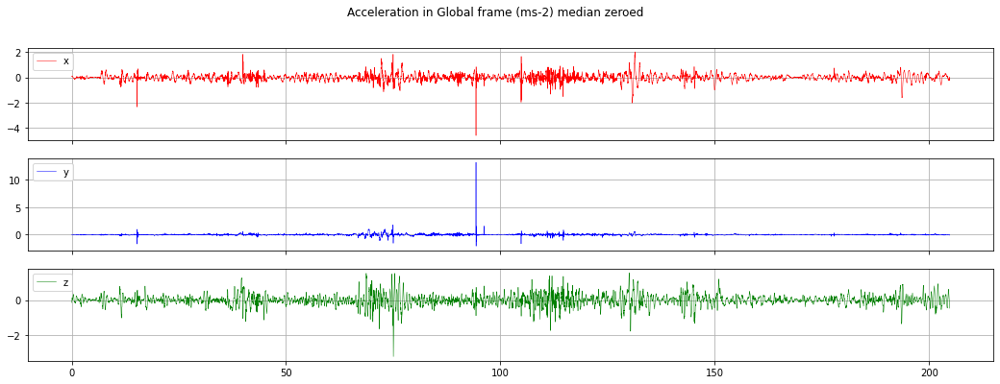

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], acc_g[:,0], label='x', linewidth=0.5, color='red')
ax[1].plot(imu[:,0], acc_g[:,1], label='y', linewidth=0.5, color='blue')
ax[2].plot(imu[:,0], acc_g[:,2], label='z', linewidth=0.5, color='green')

for a in ax:
    a.legend(loc='upper left')
    a.grid()

fig.suptitle("Acceleration in Global frame (ms-2) median zeroed");

In [ ]:
m = (acc_g[:, 0:3] * imu[:, 0, None]).sum(axis=0) / (imu[:, 0]**2).sum()
m

array([-9.35679176e-06,  2.58830248e-05,  3.07716155e-05])

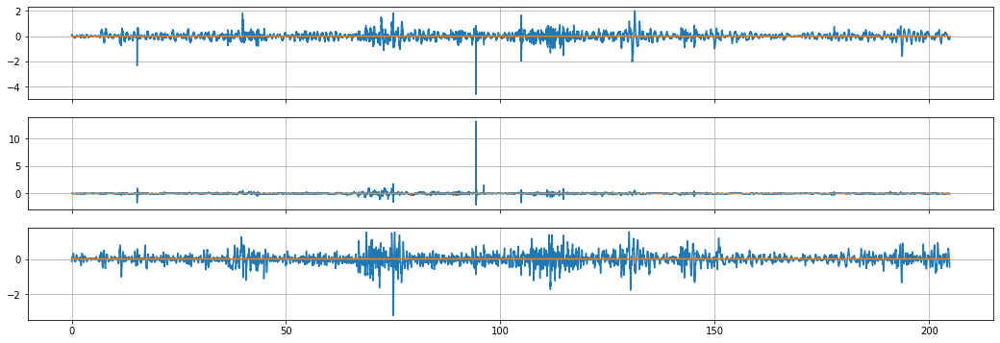

In [ ]:
fig, axs = plt.subplots(3, figsize=(18,6), sharex=True)
for ax, acc, mm in zip(axs, acc_g.T, m):
    ax.plot(imu[:,0], acc)
    ax.plot(imu[:,0], mm*(imu[:,0]))
    ax.grid()

In [ ]:
np.diff(imu[:, 0]).mean()

0.025000627036206424

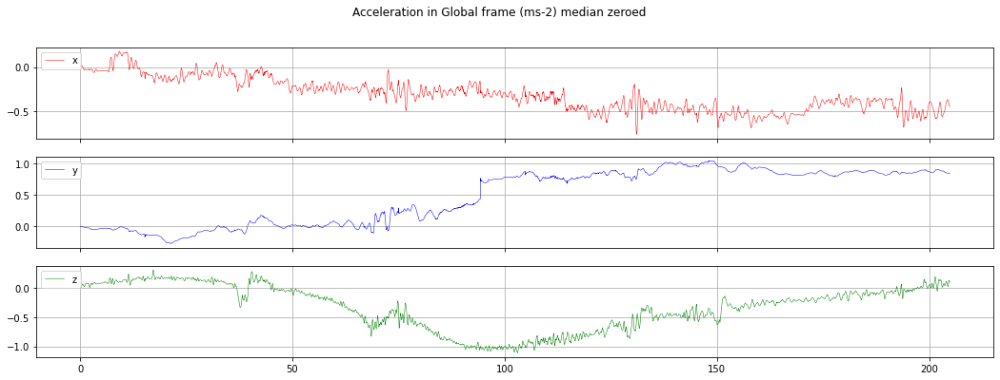

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)
v = np.cumsum(acc_g, axis=0) * 0.025
ax[0].plot(imu[:,0], v[:,0], label='x', linewidth=0.5, color='red')
ax[1].plot(imu[:,0], v[:,1], label='y', linewidth=0.5, color='blue')
ax[2].plot(imu[:,0], v[:,2], label='z', linewidth=0.5, color='green')

for a in ax:
    a.legend(loc='upper left')
    a.grid()

fig.suptitle("Acceleration in Global frame (ms-2) median zeroed");

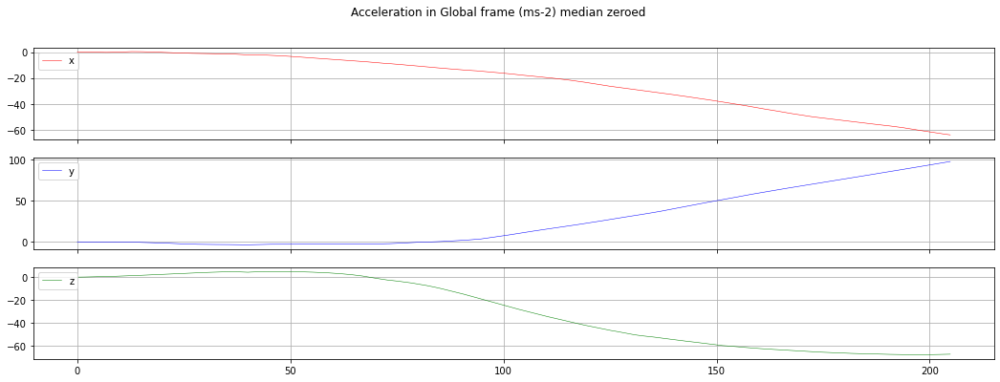

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)
x = np.cumsum(v, axis=0)  * 0.025
ax[0].plot(imu[:,0], x[:,0], label='x', linewidth=0.5, color='red')
ax[1].plot(imu[:,0], x[:,1], label='y', linewidth=0.5, color='blue')
ax[2].plot(imu[:,0], x[:,2], label='z', linewidth=0.5, color='green')

for a in ax:
    a.legend(loc='upper left')
    a.grid()

fig.suptitle("Acceleration in Global frame (ms-2) median zeroed");

p

sp.Matrix(lines)

# IMU Only Filter - Iter 1

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]

Q = np.diag((0.25, 0.25, 0.25, 0.25))  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, 1, 0),
    (0, 0, 0, 1)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
As = [c.copy() for c in acc_g[:, 0:2]]

for i in range(len(As)):
    U = As[0].reshape(-1, 1)
    X = F @ X + G @ U
    P = F @ P @ F.T + Q
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]


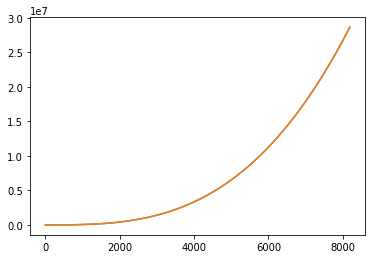

In [ ]:
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")


from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
def anim_func(frame, ax, loc):
    # print(frame)
    ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
    ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
    # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
    global prev
    prev.remove()
    prev = ret1
    return ret1, ret3, prev

anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
                     frames=len(Xs) // 40, interval=5)#, blit=True)

plt.close()
anim

# IMU+Pos Filter - Iter 1

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]

Q = np.diag((0.25, 0.25, 0.25, 0.25))  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, 1, 0),
    (0, 0, 0, 1)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

H = np.array((
    (1, 0, 0, 0),
    (0, 1, 0, 0),
))

R = np.diag((1, 1))  # Process noise

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
As = [c.copy() for c in acc_g[:, 0:2]]
Ls = [c.copy() for c in pos]

t = 0
for i in range(len(As)):
    U = As[0].reshape(-1, 1)
    X = F @ X + G @ U
    P = F @ P @ F.T + Q
    t += dt
    if len(Ls) > 0 and t > Ls[0][0]:
        Y = Ls[0][1:3].reshape(-1, 1)
        K = P @ H.T @ np.linalg.inv(H @ P @ H.T + R)
        X = X + K @ (Y - H @ X)
        P = (np.eye(4) - K @ H) @ P
        del Ls[0]
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]
np_Xs = np.stack(Xs).reshape(-1,4)

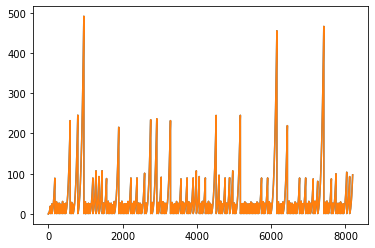

In [ ]:
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

# f, ax = plt.subplots(1,1, figsize=(18,6))

# f.suptitle('Raw Acoustic Positions')

# ax.set_aspect('equal', 'box')
# ax.set_xlim(0, 8.8)
# ax.set_ylim(0, 3.06)
# ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
# ax.plot(*zip(*path), color='red', label="Ground Truth")


# from matplotlib.animation import FuncAnimation
# from matplotlib import rc
# rc('animation', html='jshtml')

# prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
# def anim_func(frame, ax, loc):
#     # print(frame)
#     ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
#     ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
#     # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
#     global prev
#     prev.remove()
#     prev = ret1
#     return ret1, ret3, prev

# anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
#                      frames=len(Xs) // 10, interval=1, blit=True)

# plt.close()
# anim

NameError: ignored

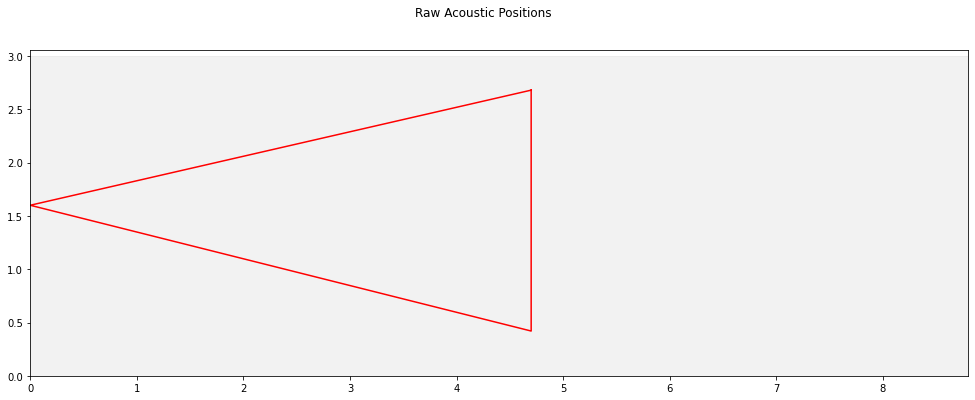

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs.T)

In [ ]:
f, axs = plt.subplots(4,1, figsize=(18,6))

for ax, col in zip(axs, np_Xs.T):
    ax.plot(col)
    ax.grid()

# See Accel in Freq Domain

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)
dt = 0.025
fs = 1.0 / dt

In [ ]:
import pywt
scale = np.linspace(0.1, 1000, 500)
f = pywt.scale2frequency('mexh', scale) / dt
f[-1], f[0]

In [ ]:
data = acc_g[:, 0]
ts = np.arange(len(data)) * dt

coef, freqs=pywt.cwt(data, scale, 'mexh', sampling_period=dt, method='fft')


f, (a1, a2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
a1.plot(ts, data)
a1.set_xlabel('s')
a1.set_ylabel('y')
a1.grid()

a2.contourf(ts, freqs, np.clip(np.abs(coef), 0,5))
a2.set_xlabel('s')
a2.set_ylabel('f')
a2.set_yscale('log')

plt.show()

In [ ]:
data = acc_g[:, 1]
ts = np.arange(len(data)) * dt

coef, freqs=pywt.cwt(data, scale, 'mexh', sampling_period=dt, method='fft')


f, (a1, a2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
a1.plot(ts, data)
a1.set_xlabel('s')
a1.set_ylabel('y')
a1.grid()

a2.contourf(ts, freqs, np.clip(np.abs(coef), 0,5))
a2.set_xlabel('s')
a2.set_ylabel('f')
a2.set_yscale('log')

plt.show()

In [ ]:
data = acc_g[:, 2]
ts = np.arange(len(data)) * dt

coef, freqs = pywt.cwt(data, scale, 'mexh', sampling_period=dt, method='fft')


f, (a1, a2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
a1.plot(ts, data)
a1.set_xlabel('s')
a1.set_ylabel('y')
a1.grid()

a2.contourf(ts, freqs, np.clip(np.abs(coef), 0,5))
a2.set_xlabel('s')
a2.set_ylabel('f')
a2.set_yscale('log')

plt.show()

In [ ]:
from scipy.signal import butter, lfilter, filtfilt, hilbert
class BP:
    def __init__(self, fs=1e6, low=40e3, high=45e3, order=5, preserve_phase=False):
        nyq = 0.5 * fs
        self.coeffs = butter(order, [low / nyq, high / nyq], btype='band')
        self.apply = filtfilt if preserve_phase else lfilter

    def __call__(self, data):
        return self.apply(*self.coeffs, data, axis=0)


In [ ]:
acc_bp = BP(fs=1.0/dt, low=1e-1, high=1.5e1)(acc_g)

In [ ]:
data = acc_bp[:, 0]
ts = np.arange(len(data)) * dt

coef, freqs=pywt.cwt(data, scale, 'mexh', sampling_period=dt, method='fft')


f, (a1, a2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
a1.plot(ts, data)
a1.set_xlabel('s')
a1.set_ylabel('y')
a1.grid()

a2.contourf(ts, freqs, np.clip(np.abs(coef), 0,5))
a2.set_xlabel('s')
a2.set_ylabel('f')
a2.set_yscale('log')

plt.show()

In [ ]:
data = acc_bp[:, 1]
ts = np.arange(len(data)) * dt

coef, freqs=pywt.cwt(data, scale, 'mexh', sampling_period=dt, method='fft')


f, (a1, a2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
a1.plot(ts, data)
a1.set_xlabel('s')
a1.set_ylabel('y')
a1.grid()

a2.contourf(ts, freqs, np.clip(np.abs(coef), 0,5))
a2.set_xlabel('s')
a2.set_ylabel('f')
a2.set_yscale('log')

plt.show()

In [ ]:
data = acc_bp[:, 0]
ts = np.arange(len(data)) * dt

f, (a1, a2) = plt.subplots(2, 1, sharex=True, figsize=(20,10))
a1.plot(ts, data)
a1.set_xlabel('s')
a1.set_ylabel('y')
a1.grid()

a2.plot(ts, acc_g[:, 0])
a2.set_xlabel('s')
a2.set_ylabel('y')
a2.grid()

plt.show()

# IMU+Pos Filter - Iter 2

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]

Q = np.diag((0.001, 0.001, 0.001, 0.001))  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, 1, 0),
    (0, 0, 0, 1)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

H = np.array((
    (1, 0, 0, 0),
    (0, 1, 0, 0),
))

R = np.diag((1, 1))  # Measurement noise

In [ ]:
Xs = [X.copy()] 
Ps = [P.copy()]

As = [c.copy() for c in acc_g[:, 0:2]] # Acceleration in the gloabal frame # 20Hz
Ls = [c.copy() for c in pos]  # Positions from the hydrophones # 1Hz 

## X
# x
# y
# v_x
# v_y

## U
# a_N
# a_E

t = 0
for i in range(len(As)):
    # Process
    U = As[0].reshape(-1, 1)

    # New X == F @ old X + transform @ inputs
    X = F @ X + G @ U

    # X_new = x_old + v_old * dt 
    # V_new = v_old              + a_current * dt

    # Q: Process noise
    # 
    P = F @ P @ F.T + Q

    t += dt

    # Measurement
    if len(Ls) > 0 and t > Ls[0][0]:
        # Measurement that we got form hydrophones 
        Y = Ls[0][1:3].reshape(-1, 1)

        # X_new = X_old + some_factor * (measurement_x - current_estimate_of_x)
        # some_factor === kalman_gain

        # H
        # Y = H @ X 
        # 
        # R
        K = P @ H.T @ np.linalg.inv(H @ P @ H.T + R)
        
        X = X + K @ (Y - H @ X)
        
        P = (np.eye(4) - K @ H) @ P
        del Ls[0]
    
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]
np_Xs = np.stack(Xs).reshape(-1,4)

In [ ]:
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

# f, ax = plt.subplots(1,1, figsize=(18,6))

# f.suptitle('Raw Acoustic Positions')

# ax.set_aspect('equal', 'box')
# ax.set_xlim(0, 8.8)
# ax.set_ylim(0, 3.06)
# ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
# ax.plot(*zip(*path), color='red', label="Ground Truth")


# from matplotlib.animation import FuncAnimation
# from matplotlib import rc
# rc('animation', html='jshtml')

# prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
# def anim_func(frame, ax, loc):
#     # print(frame)
#     ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
#     ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
#     # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
#     global prev
#     prev.remove()
#     prev = ret1
#     return ret1, ret3, prev

# anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
#                      frames=len(Xs) // 10, interval=1, blit=True)

# plt.close()
# anim

In [ ]:
def, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs.T)

In [ ]:
f, axs = plt.subplots(4,1, figsize=(18,6))

for ax, col in zip(axs, np_Xs.T):
    ax.plot(col)
    ax.grid()

# IMU+Pos Filter - Iter 4 use v_Avg from position

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

gamma = 1

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]


Q = np.diag([0.5]*4) * dt  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, gamma, 0),
    (0, 0, 0, gamma)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

H = np.array((
    (1, 0, 0, 0),
    (0, 1, 0, 0),
    (0, 0, 1, 0),
    (0, 0, 0, 1),
))

R = np.diag([2] * 2 + [0.5] * 2)  # Measurement noise

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
As = [c.copy() for c in acc_g[:, 0:2]]
Ls = [c.copy() for c in pos]

t = 0
t_prev = t
x_prev = Xs[0].copy().reshape(-1)[:2]

np.set_printoptions(suppress=True, precision=2, sign='+')

for i in range(len(As)):
    U = As[0].reshape(-1, 1)
    X = F @ X + G @ U
    P = F @ P @ F.T + Q
    t += dt
    if len(Ls) > 0 and t > Ls[0][0]:
        Y = np.hstack((Ls[0][1:3].reshape(-1), (Ls[0][1:3] - x_prev) / (t-t_prev))).reshape(-1, 1)
        print(f"dt\t{t-t_prev:.0f}\nEst\t{X.ravel()}\nMeas\t{Y.ravel()}")
        K = P @ H.T @ np.linalg.inv(H @ P @ H.T + R)
        X = X + K @ (Y - H @ X)
        P = (np.eye(4) - K @ H) @ P
        print(f"Corr\t{X.ravel()}")
        t_prev = t
        x_prev[...] = Ls[0][1:3]  # X[...]
        del Ls[0]
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]
np_Xs = np.stack(Xs).reshape(-1,4)

dt	0
Est	[+4.37 +2.02 +0.92 +0.  ]
Meas	[+4.29 +1.04 +0.28 -2.96]
Corr	[+4.34 +1.85 +0.76 -0.73]
dt	1
Est	[+3.65 +0.63 -1.23 -1.37]
Meas	[+4.34 +1.3  +0.04 +0.24]
Corr	[+4.2  +1.27 -0.49 -0.44]
dt	1
Est	[+3.61 +0.49 -0.49 -1.22]
Meas	[+5.19 +2.53 +0.83 +1.2 ]
Corr	[+4.68 +2.09 +0.38 +0.32]
dt	2
Est	[+4.52 +2.01 -0.35 +0.2 ]
Meas	[+4.09 +0.96 -0.56 -0.8 ]
Corr	[+4.18 +1.   -0.52 -0.52]
dt	1
Est	[+3.73 +0.66 -0.28 -0.05]
Meas	[+4.3  +1.32 +0.19 +0.32]
Corr	[+4.16 +1.12 +0.04 +0.22]
dt	1
Est	[+4.2  +1.29 -0.15 +0.08]
Meas	[+4.59 +1.69 +0.29 +0.37]
Corr	[+4.51 +1.57 +0.13 +0.27]
dt	1
Est	[+7.54 +1.52 +2.69 -0.67]
Meas	[+5.1  +2.4  +0.49 +0.69]
Corr	[+5.75 +2.32 +1.25 +0.18]
dt	1
Est	[+8.5  +2.55 +6.07 +0.59]
Meas	[+4.   +1.08 -1.15 -1.4 ]
Corr	[+4.48 +1.33 +1.64 -0.64]
dt	1
Est	[+6.7  +1.57 +1.86 +0.84]
Meas	[+4.48 +1.2  +0.42 +0.11]
Corr	[+5.18 +1.18 +0.86 +0.39]
dt	1
Est	[+6.04 +1.27 +1.44 -0.36]
Meas	[+4.59 +1.69 +0.12 +0.49]
Corr	[+4.98 +1.7  +0.58 +0.16]
dt	1
Est	[+3.55 +1.1  -6.81 -1

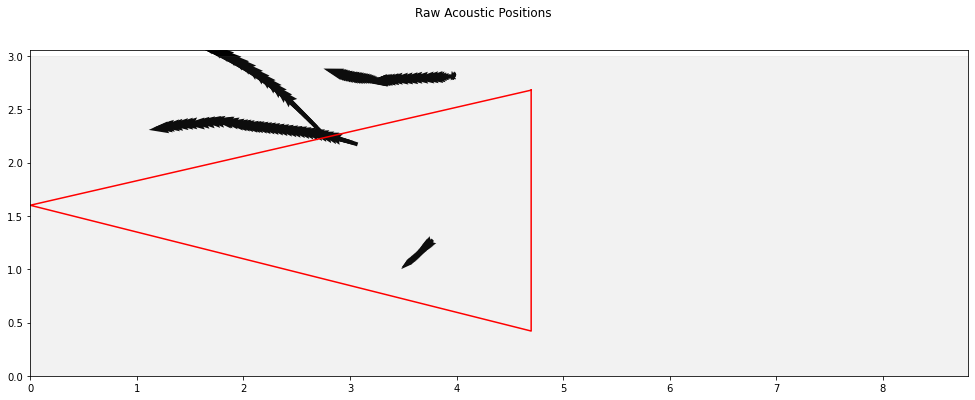

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs[:200, :].T)

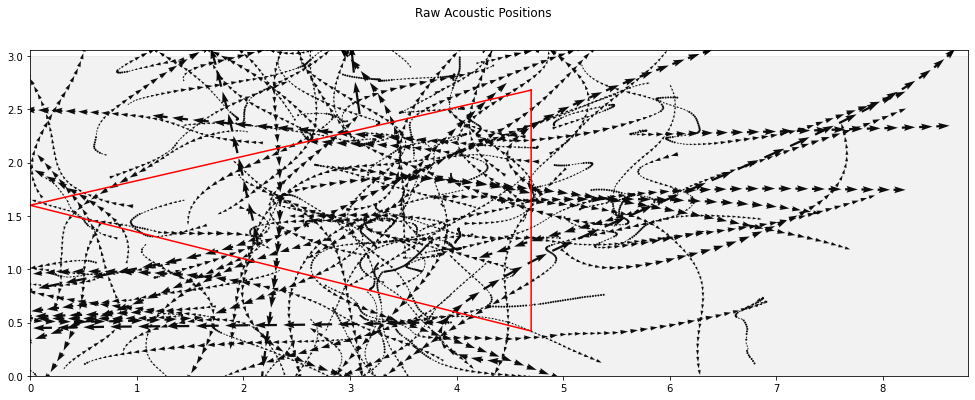

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs.T)

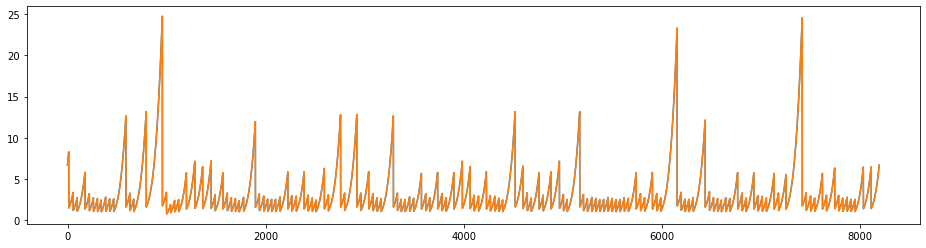

In [ ]:
plt.figure(figsize=(16, 4))
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")


from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
def anim_func(frame, ax, loc):
    # print(frame)
    ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
    ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
    # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
    global prev
    prev.remove()
    prev = ret1
    return ret1, ret3, prev

anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
                     frames=len(Xs) // 10, interval=1, blit=True)

plt.close()
anim

In [ ]:
f, axs = plt.subplots(4,1, figsize=(18,6))

for ax, col in zip(axs, np_Xs.T):
    ax.plot(col)
    ax.grid()

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ imu[:, 4:7].reshape(-1, 3, 1)).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

gamma = 0.8

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]


Q = np.diag([0.4]*4) * dt  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, gamma, 0),
    (0, 0, 0, gamma)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

H = np.array((
    (1, 0, 0, 0),
    (0, 1, 0, 0),
))

R = np.diag([2] * 2)  # Measurement noise

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
As = [c.copy() for c in acc_g[:, 0:2]]
Ls = [c.copy() for c in pos]

t = 0
for i in range(len(As)):
    U = As[0].reshape(-1, 1)
    X = F @ X + G @ U
    P = F @ P @ F.T + Q
    t += dt
    if len(Ls) > 0 and t > Ls[0][0]:
        Y = Ls[0][1:3].reshape(-1, 1)
        K = P @ H.T @ np.linalg.inv(H @ P @ H.T + R)
        X = X + K @ (Y - H @ X)
        P = (np.eye(4) - K @ H) @ P
        del Ls[0]
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]
np_Xs = np.stack(Xs).reshape(-1,4)

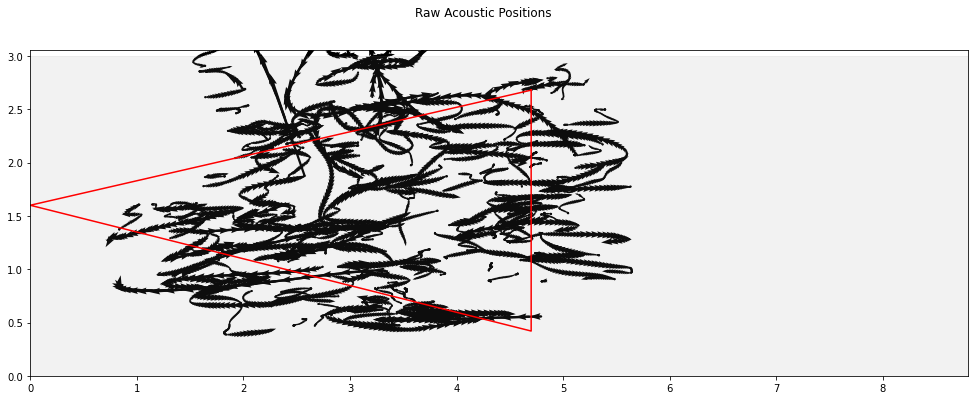

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs.T)

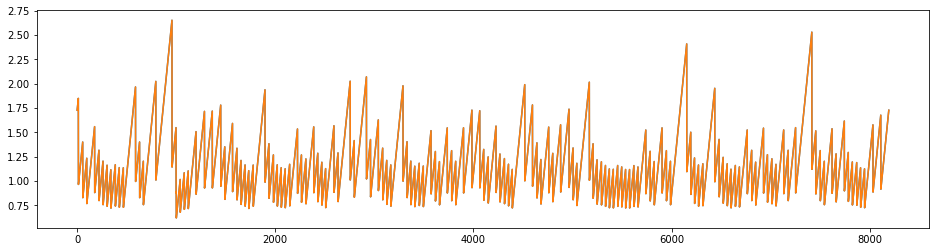

In [ ]:
plt.figure(figsize=(16, 4))
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")


from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
def anim_func(frame, ax, loc):
    # print(frame)
    ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
    ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
    # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
    global prev
    prev.remove()
    prev = ret1
    return ret1, ret3, prev

anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
                     frames=len(Xs) // 10, interval=1, blit=True)

plt.close()
anim

Animation size has reached 20981234 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


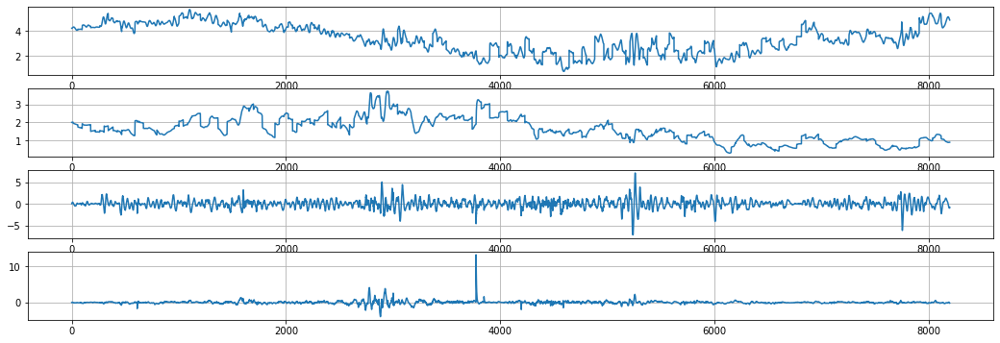

In [ ]:
f, axs = plt.subplots(4,1, figsize=(18,6))

for ax, col in zip(axs, np_Xs.T):
    ax.plot(col)
    ax.grid()

# IMU+Pos Filter - Iter 4 use v_Avg from position, remove bias in body frame then highpass

In [ ]:
acc = imu[:, 4:7].reshape(-1, 3, 1).copy()
acc -= np.percentile(acc, 50, axis=0)

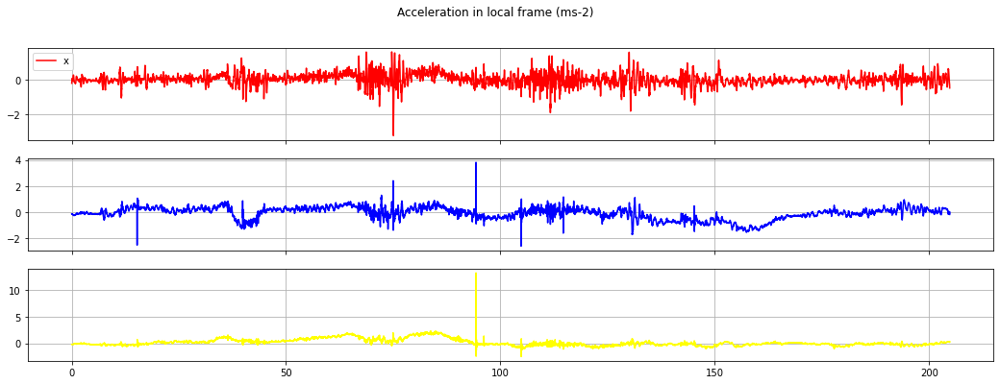

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], acc[:,0], label='x', color='red')
ax[0].legend()
ax[1].plot(imu[:,0], acc[:,1], color='blue', label='y')
ax[0].legend()
ax[2].plot(imu[:,0], acc[:,2], color='yellow', label='y')
for a in ax:
    a.grid()

fig.suptitle("Acceleration in local frame (ms-2)");

In [ ]:
from scipy.signal import butter, lfilter, filtfilt, hilbert
class HP:
    def __init__(self, fs=1e6, f=40e3, order=5, preserve_phase=True):
        nyq = 0.5 * fs
        self.coeffs = butter(order, f / nyq, btype='highpass')
        self.apply = filtfilt if preserve_phase else lfilter

    def __call__(self, data):
        return self.apply(*self.coeffs, data, axis=0)


In [ ]:
acc_h = HP(fs=1.0/dt, f=1e0)(acc)

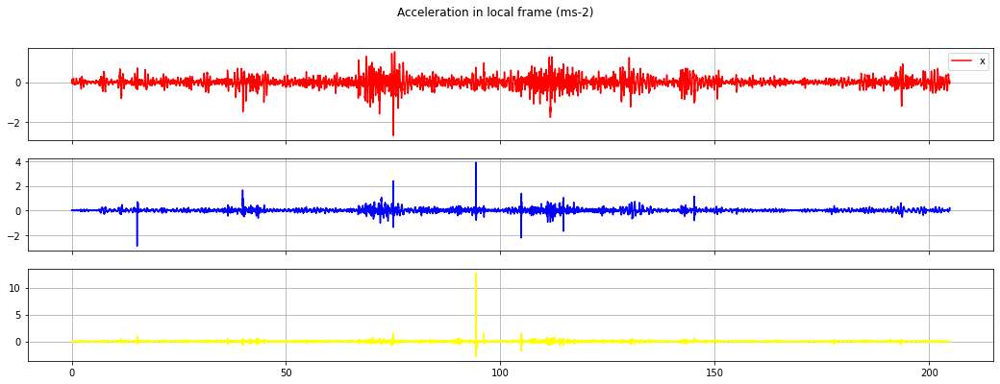

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], acc_h[:,0], label='x', color='red')
ax[0].legend()
ax[1].plot(imu[:,0], acc_h[:,1], color='blue', label='y')
ax[0].legend()
ax[2].plot(imu[:,0], acc_h[:,2], color='yellow', label='y')
for a in ax:
    a.grid()

fig.suptitle("Acceleration in local frame (ms-2)");

In [ ]:
acc = acc_h

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ acc).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

gamma = 1

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]


Q = np.diag([0.5]*4) * dt  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, gamma, 0),
    (0, 0, 0, gamma)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

H = np.array((
    (1, 0, 0, 0),
    (0, 1, 0, 0),
    (0, 0, 1, 0),
    (0, 0, 0, 1),
))

R = np.diag([2] * 2 + [0.5] * 2)  # Measurement noise

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
As = [c.copy() for c in acc_g[:, 0:2]]
Ls = [c.copy() for c in pos]

t = 0
t_prev = t
x_prev = Xs[0].copy().reshape(-1)[:2]

np.set_printoptions(suppress=True, precision=2, sign='+')

for i in range(len(As)):
    U = As[0].reshape(-1, 1)
    X = F @ X + G @ U
    P = F @ P @ F.T + Q
    t += dt
    if len(Ls) > 0 and t > Ls[0][0]:
        Y = np.hstack((Ls[0][1:3].reshape(-1), (Ls[0][1:3] - x_prev) / (t-t_prev))).reshape(-1, 1)
        print(f"dt\t{t-t_prev:.0f}\nEst\t{X.ravel()}\nMeas\t{Y.ravel()}")
        K = P @ H.T @ np.linalg.inv(H @ P @ H.T + R)
        X = X + K @ (Y - H @ X)
        P = (np.eye(4) - K @ H) @ P
        print(f"Corr\t{X.ravel()}")
        t_prev = t
        x_prev[...] = Ls[0][1:3]  # X[...]
        del Ls[0]
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]
np_Xs = np.stack(Xs).reshape(-1,4)

dt	0
Est	[+4.25 +2.   +0.35 -0.01]
Meas	[+4.29 +1.04 +0.28 -2.96]
Corr	[+4.25 +1.83 +0.33 -0.74]
dt	1
Est	[+4.53 +1.04 +0.33 -0.64]
Meas	[+4.34 +1.3  +0.04 +0.24]
Corr	[+4.39 +1.36 +0.16 -0.14]
dt	1
Est	[+4.46 +1.17 +0.08 -0.13]
Meas	[+5.19 +2.53 +0.83 +1.2 ]
Corr	[+5.   +2.15 +0.56 +0.73]
dt	2
Est	[+6.22 +3.57 +0.69 +0.76]
Meas	[+4.09 +0.96 -0.56 -0.8 ]
Corr	[+4.46 +1.4  -0.29 -0.46]
dt	1
Est	[+4.14 +0.89 -0.21 -0.42]
Meas	[+4.3  +1.32 +0.19 +0.32]
Corr	[+4.33 +1.33 +0.04 +0.05]
dt	1
Est	[+4.37 +1.36 +0.44 +0.1 ]
Meas	[+4.59 +1.69 +0.29 +0.37]
Corr	[+4.44 +1.6  +0.37 +0.28]
dt	1
Est	[+4.5  +1.84 -0.25 +0.19]
Meas	[+5.1  +2.4  +0.49 +0.69]
Corr	[+4.99 +2.25 +0.22 +0.52]
dt	1
Est	[+5.35 +2.79 +0.22 +0.59]
Meas	[+4.   +1.08 -1.15 -1.4 ]
Corr	[+4.35 +1.46 -0.65 -0.66]
dt	1
Est	[+3.86 +0.75 -0.57 -0.58]
Meas	[+4.48 +1.2  +0.42 +0.11]
Corr	[+4.45 +1.17 +0.06 -0.14]
dt	1
Est	[+4.74 +0.99 -0.08 -0.15]
Meas	[+4.59 +1.69 +0.12 +0.49]
Corr	[+4.72 +1.5  +0.02 +0.27]
dt	1
Est	[+5.06 +1.77 -1.03 +0

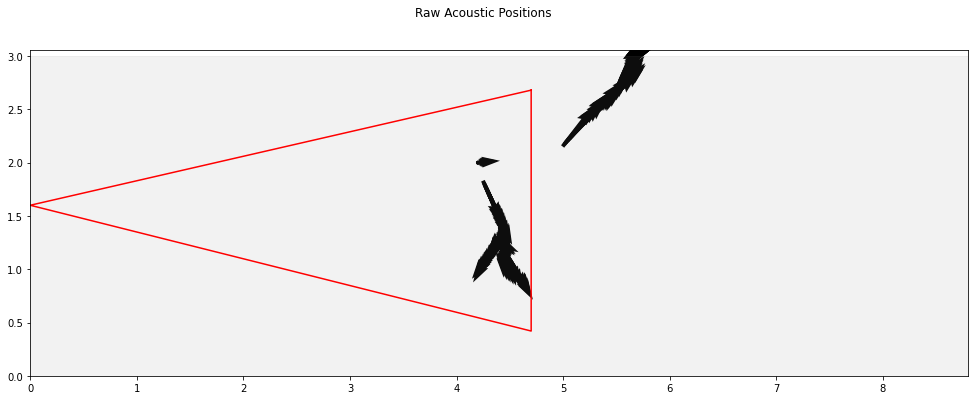

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs[:200, :].T)

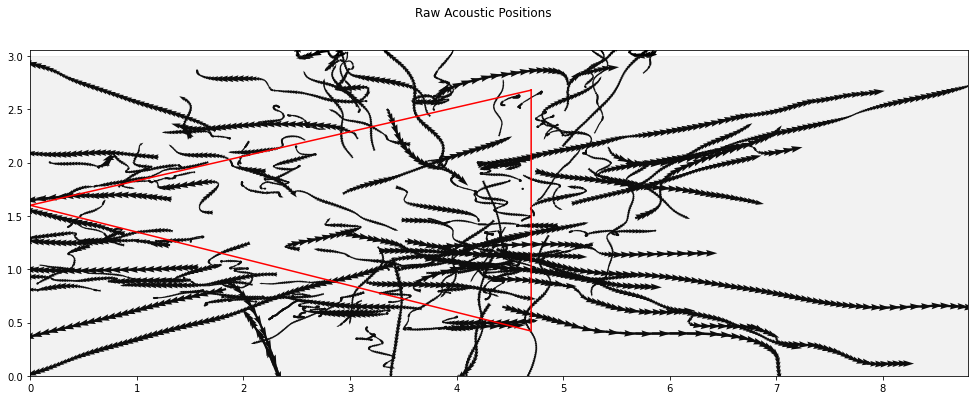

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs.T)

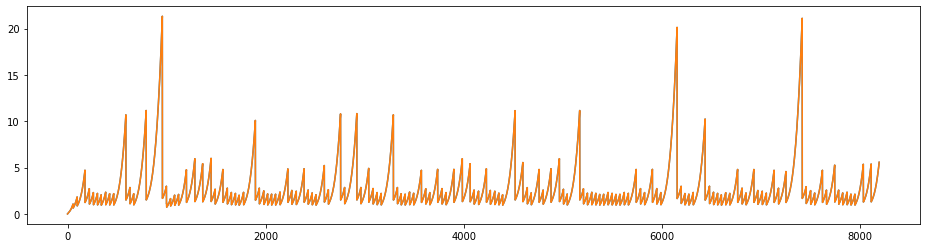

In [ ]:
plt.figure(figsize=(16, 4))
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")


from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
def anim_func(frame, ax, loc):
    # print(frame)
    ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
    ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
    # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
    global prev
    prev.remove()
    prev = ret1
    return ret1, ret3, prev

anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
                     frames=len(Xs) // 10, interval=1, blit=True)

plt.close()
anim

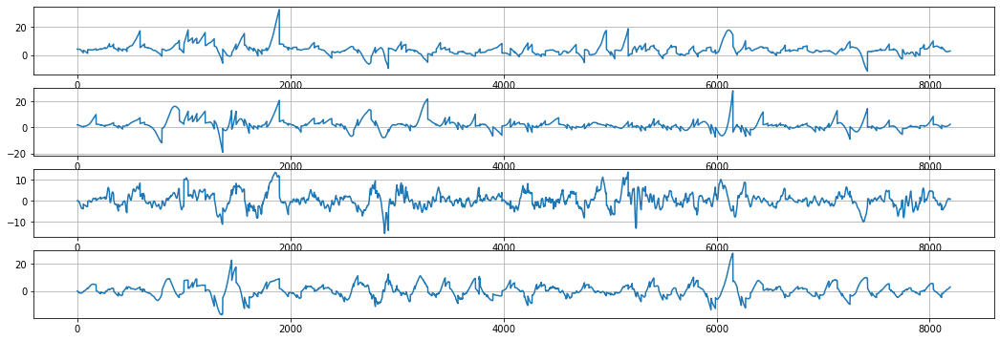

In [ ]:
f, axs = plt.subplots(4,1, figsize=(18,6))

for ax, col in zip(axs, np_Xs.T):
    ax.plot(col)
    ax.grid()

#IMU only with HP filter

In [ ]:
acc = imu[:, 4:7].reshape(-1, 3, 1).copy()
acc -= np.percentile(acc, 50, axis=0)

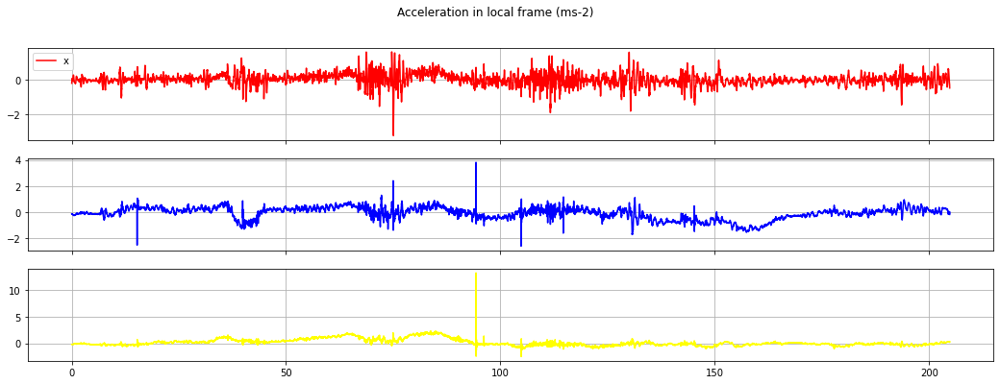

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], acc[:,0], label='x', color='red')
ax[0].legend()
ax[1].plot(imu[:,0], acc[:,1], color='blue', label='y')
ax[0].legend()
ax[2].plot(imu[:,0], acc[:,2], color='yellow', label='y')
for a in ax:
    a.grid()

fig.suptitle("Acceleration in local frame (ms-2)");

In [ ]:
from scipy.signal import butter, lfilter, filtfilt, hilbert
class HP:
    def __init__(self, fs=1e6, f=40e3, order=5, preserve_phase=True):
        nyq = 0.5 * fs
        self.coeffs = butter(order, f / nyq, btype='highpass')
        self.apply = filtfilt if preserve_phase else lfilter

    def __call__(self, data):
        return self.apply(*self.coeffs, data, axis=0)


In [ ]:
acc_h = HP(fs=1.0/dt, f=1e0)(acc)

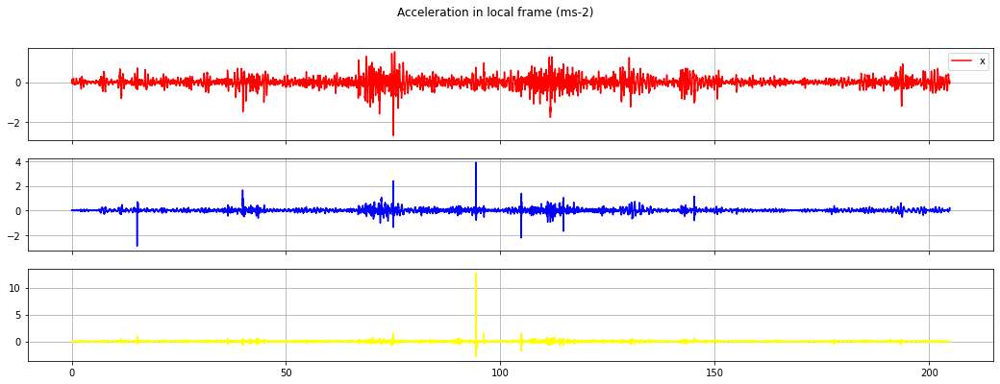

In [ ]:
fig, ax = plt.subplots(3, figsize=(18,6), sharex=True)

ax[0].plot(imu[:,0], acc_h[:,0], label='x', color='red')
ax[0].legend()
ax[1].plot(imu[:,0], acc_h[:,1], color='blue', label='y')
ax[0].legend()
ax[2].plot(imu[:,0], acc_h[:,2], color='yellow', label='y')
for a in ax:
    a.grid()

fig.suptitle("Acceleration in local frame (ms-2)");

In [ ]:
acc = acc_h

In [ ]:
# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ acc).reshape(-1, 3)
acc_g = acc_g - np.percentile(acc_g, 50, axis=0) # - acc_g.mean(axis=0)

In [ ]:
dt = 0.025

gamma = 1

X = np.array(  # Initial State
    (4.2, 2.0, 0, 0)
).reshape(-1,1)  # np.ndarry[4,1]

P = np.diag((0,0,0,0)) # Initial Cov
# np.ndarry[4,4]


Q = np.diag([0.5]*4) * dt  # Process noise
# np.ndarry[4,4]

F = np.array((  # State propogation: x_k = F @ x_{k-1} + G @ u_k + _w
    (1, 0, dt, 0),
    (0, 1, 0, dt),
    (0, 0, gamma, 0),
    (0, 0, 0, gamma)
))  # np.ndarry[4,4]

G = np.array((
    (0, 0),
    (0, 0),
    (1, 0),
    (0, 1)
))  # np.ndarry[4,2]

H = np.array((
    (1, 0, 0, 0),
    (0, 1, 0, 0),
    (0, 0, 1, 0),
    (0, 0, 0, 1),
))

R = np.diag([2] * 2 + [0.5] * 2)  # Measurement noise

In [ ]:
Xs = [X.copy()]
Ps = [P.copy()]
As = [c.copy() for c in acc_g[:, 0:2]]
Ls = [c.copy() for c in pos]

t = 0
t_prev = t
x_prev = Xs[0].copy().reshape(-1)[:2]

np.set_printoptions(suppress=True, precision=2, sign='+')

for i in range(len(As)):
    U = As[0].reshape(-1, 1)
    X = F @ X + G @ U
    P = F @ P @ F.T + Q
    t += dt
 
    Xs.append(X.copy())
    Ps.append(P.copy())
    del As[0]
np_Xs = np.stack(Xs).reshape(-1,4)

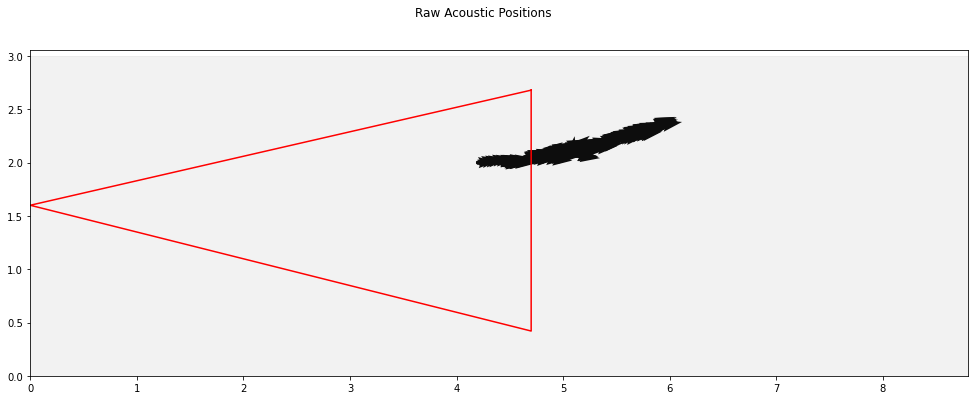

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs[:200, :].T)

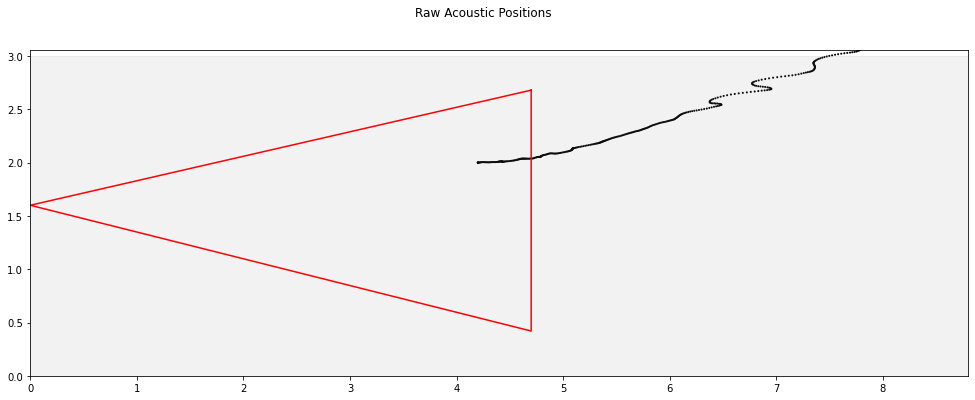

In [ ]:
f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")
ax.quiver(*np_Xs.T)

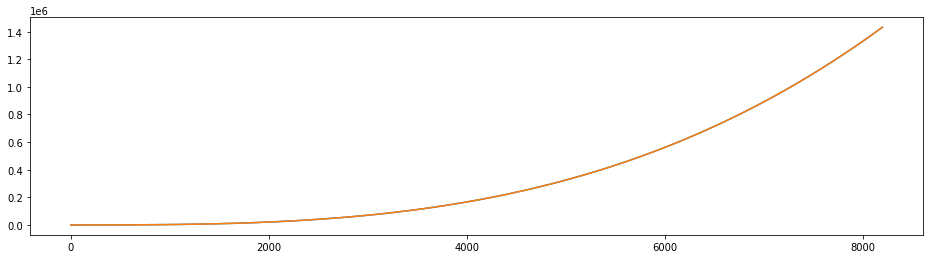

In [ ]:
plt.figure(figsize=(16, 4))
plt.plot(np.stack(Ps)[:, 0, 0])
plt.plot(np.stack(Ps)[:, 1, 1])

In [ ]:

f, ax = plt.subplots(1,1, figsize=(18,6))

f.suptitle('Raw Acoustic Positions')

ax.set_aspect('equal', 'box')
ax.set_xlim(0, 8.8)
ax.set_ylim(0, 3.06)
ax.add_patch(mp_patches.Rectangle((0, 0), L, W, alpha=0.1, color='gray'))
ax.plot(*zip(*path), color='red', label="Ground Truth")


from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

prev = ax.add_patch(mp_patches.Ellipse((0,0), 1,1 , alpha=0.2, color='black'))
def anim_func(frame, ax, loc):
    # print(frame)
    ret1 = ax.add_patch(mp_patches.Ellipse(Xs[frame], Ps[frame][0, 0], Ps[frame][1, 1], alpha=0.2, color='black'))
    ret3 = ax.scatter(*Xs[frame][:2], color='red', s=2)
    # ret2 = ax.scatter(*pos[frame, 1:3], color='green', alpha=0.5)
    global prev
    prev.remove()
    prev = ret1
    return ret1, ret3, prev

anim = FuncAnimation(f, anim_func, fargs=(ax, None), 
                     frames=len(Xs) // 10, interval=1, blit=True)

plt.close()
anim

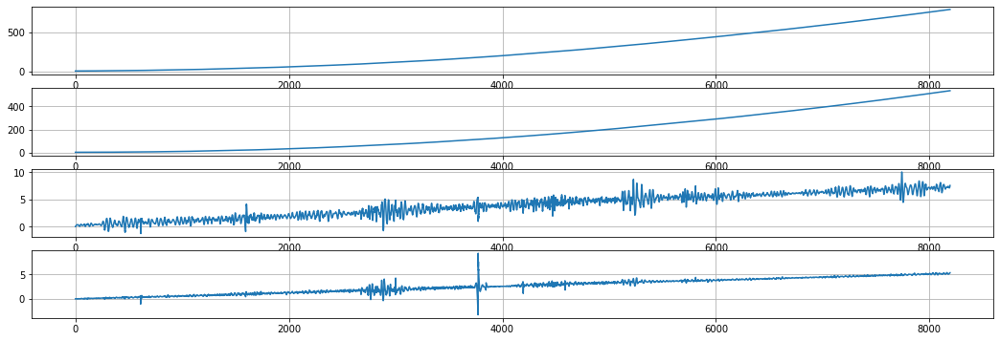

In [ ]:
f, axs = plt.subplots(4,1, figsize=(18,6))

for ax, col in zip(axs, np_Xs.T):
    ax.plot(col)
    ax.grid()

# Allan Var cause why not

In [ ]:
# FROM: https://github.com/nmayorov/al  lan-variance
# Author: Nikolay Mayorov <nikolay.mayorov@zoho.com>

from __future__ import division
import numpy as np
import pandas as pd
from scipy.optimize import nnls


def _compute_cluster_sizes(n_samples, dt, tau_min, tau_max, n_clusters):
    if tau_min is None:
        min_size = 1
    else:
        min_size = int(tau_min / dt)

    if tau_max is None:
        max_size = n_samples // 10
    else:
        max_size = int(tau_max / dt)

    result = np.logspace(np.log2(min_size), np.log2(max_size),
                         num=n_clusters, base=2)

    return np.unique(np.round(result)).astype(int)


def allan_variance(x, dt=1, tau_min=None, tau_max=None,
                   n_clusters=100, input_type='mean'):
    """Compute Allan variance (AVAR).
    Consider an underlying measurement y(t). Our sensors output integrals of
    y(t) over successive time intervals of length dt. These measurements
    x(k * dt) form the input to this function.
    Allan variance is defined for different averaging times tau = m * dt as
    follows::
        AVAR(tau) = 1/2 * <(Y(k + m) - Y(k))>,
    where Y(j) is the time average value of y(t) over [k * dt, (k + m) * dt]
    (call it a cluster), and < ... > means averaging over different clusters.
    If we define X(j) being an integral of x(s) from 0 to dt * j,
    we can rewrite the AVAR as  follows::
        AVAR(tau) = 1/(2 * tau**2) * <X(k + 2 * m) - 2 * X(k + m) + X(k)>
    We implement < ... > by averaging over different clusters of a given sample
    with overlapping, and X(j) is readily available from x.
    Parameters
    ----------
    x : ndarray, shape (n, ...)
        Sensor readings, interpretation depends on `input_type` argument.
        Assumed to vary along the 0-th axis.
    dt : float, optional
        Sampling period. Default is 1.
    tau_min : float or None, optional
        Minimum averaging time to use. If None (default), it is assigned equal
        to `dt`.
    tau_max : float or None, optional
        Maximum averaging time to use. If None (default), it is chosen
        automatically such that to averaging is done over 10 *independent*
        clusters.
    n_clusters : int, optional
        Number of clusters to compute Allan variance for. The averaging times
        will be spread approximately uniform in a log scale. Default is 100.
    input_type : {'mean', 'increment', 'integral'}, optional
        How to interpret the input data:
            - 'mean': `x` is assumed to contain mean values of y over
              successive time intervals.
            - 'increment': `x` is assumed to contain integral increments over
              successive time intervals.
            - 'integral': `x` is assumed to contain cumulative integral of
              y from the time start.
        Note that 'mean' can be used when passing filtered and sampled value
        of y. But in this case generally the filtering process affects
        properties of the underlying signal y and "effective" Allan variance
        is computed, i.e. you can use obtained parameters when working with
        the sampled signal.
    Returns
    -------
    tau : ndarray
        Averaging times for which Allan variance was computed, 1-d array.
    avar : ndarray
        Values of AVAR. The 0-th dimension is the same as for `tau`. The
        trailing dimensions match ones for `x`.
    References
    ----------
    .. [1] https://en.wikipedia.org/wiki/Allan_variance
    """
    ALLOWED_INPUT_TYPES = ['mean', 'increment', 'integral']

    if input_type not in ALLOWED_INPUT_TYPES:
        raise ValueError("`input_type` must be one of {}."
                         .format(ALLOWED_INPUT_TYPES))

    x = np.asarray(x, dtype=float)
    if input_type == 'integral':
        X = x
    else:
        X = np.cumsum(x, axis=0)

    cluster_sizes = _compute_cluster_sizes(len(x), dt, tau_min, tau_max,
                                           n_clusters)

    avar = np.empty(cluster_sizes.shape + X.shape[1:])
    for i, k in enumerate(cluster_sizes):
        c = X[2*k:] - 2 * X[k:-k] + X[:-2*k]
        avar[i] = np.mean(c**2, axis=0) / k / k

    if input_type == 'mean':
        avar *= 0.5
    else:
        avar *= 0.5 / dt**2

    return cluster_sizes * dt, avar


def params_from_avar(tau, avar, effects=None, sensor_names=None):
    """Estimate noise parameters from Allan variance.
    The parameters being estimated are typical for inertial sensors:
    quantization noise, additive white noise, flicker noise (long term bias
    instability), random walk and linear ramp (this is a deterministic effect).
    The parameters are estimated using linear least squares with weights
    inversely proportional to the values of Allan variance. That is the sum of
    relative error is minimized. This approach is approximately equivalent of
    doing estimation in the log-log scale.
    Parameters
    ----------
    tau : ndarray, shape (n,)
        Values of averaging time.
    avar : ndarray, shape (n,) or (n, m)
        Values of Allan variance corresponding to `tau`.
    effects : list or None, optional
        Which effects to estimate. Allowed effects are 'quantization', 'white',
        'flicker', 'walk', 'ramp'. If None (default), estimate all of the
        mentioned above effects.
    sensor_names : list or None, optional
        How to name sensors in the output. If None (default), use integer
        values as names.
    Returns
    -------
    params : pandas DataFrame or Series
        Estimated parameters.
    prediction : ndarray, shape (n,) or (n, m)
        Predicted values of Allan variance using the estimated parameters.
    """
    ALLOWED_EFFECTS = ['quantization', 'white', 'flicker', 'walk', 'ramp']

    avar = np.asarray(avar)
    single_series = avar.ndim == 1
    if single_series:
        avar = avar[:, None]

    if effects is None:
        effects = ALLOWED_EFFECTS
    elif not set(effects) <= set(ALLOWED_EFFECTS):
        raise ValueError("Unknown effects are passed.")

    n = len(tau)

    A = np.empty((n, 5))
    A[:, 0] = 3 / tau**2
    A[:, 1] = 1 / tau
    A[:, 2] = 2 * np.log(2) / np.pi
    A[:, 3] = tau / 3
    A[:, 4] = tau**2 / 2
    mask = ['quantization' in effects,
            'white' in effects,
            'flicker' in effects,
            'walk' in effects,
            'ramp' in effects]

    A = A[:, mask]
    effects = np.asarray(ALLOWED_EFFECTS)[mask]

    params = []
    prediction = []

    for column in range(avar.shape[1]):
        avar_single = avar[:, column]
        A_scaled = A / avar_single[:, None]
        x = nnls(A_scaled, np.ones(n))[0]
        prediction.append(A_scaled.dot(x) * avar_single)
        params.append(np.sqrt(x))

    params = np.asarray(params)
    prediction = np.asarray(prediction).T

    params = pd.DataFrame(params, index=sensor_names, columns=effects)

    if single_series:
        params = params.iloc[0]
        prediction = prediction[:, 0]

    return params, prediction

In [ ]:
acc = imu[:, 4:7].reshape(-1, 3, 1).copy()

# There has to be an easier way to rotate XD
cc, ss = np.cos(np.deg2rad(imu[:, 1:4])), np.sin(np.deg2rad(imu[:, 1:4]))
z = np.zeros_like(imu[:, 1])
o = np.ones_like(imu[:, 1])

R1 = np.moveaxis(np.array((
    (cc[:,0], -ss[:,0], z),
    (ss[:,0],  cc[:,0], z),
    (      z,        z, o)
)), -1, 0)

R2 = np.moveaxis(np.array((
    ( cc[:, 1], z, ss[:, 1]),
    (        z, o,        z),
    (-ss[:, 1], z, cc[:, 1])
)), -1, 0)
R3 = np.moveaxis(np.array((
    (o,        z,         z),
    (z, cc[:, 2], -ss[:, 2]),
    (z, ss[:, 2],  cc[:, 2])
)), -1, 0)

acc_g = (R1 @ R2 @ R3 @ acc).reshape(-1, 3)

-9.79608733827271 -9.80271304159491 -9.794571083172427
quantization    0.000000
white           1.073617
flicker         0.719627
walk            0.000000
ramp            0.000000
Name: 0, dtype: float64


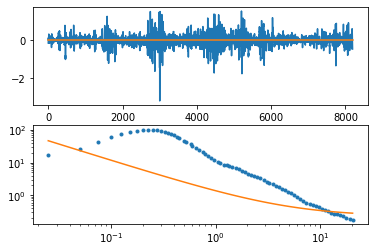

In [ ]:
d = acc_g[:, 2] # imu[:, 5]

print(np.mean(d[:int(1e3)]), np.mean(d[:]), np.mean(d[-int(1e3):]))

fig, ax = plt.subplots(2)
ax[0].plot(d - np.mean(d[:int(1e3)]))
ax[0].plot([0, len(d)], [0,0])

tau, av = allan_variance(d, 1.0/fs, input_type='increment')
ax[1].loglog(tau, av, '.')
params, av_pred = params_from_avar(tau, av)
ax[1].loglog(tau, av_pred)
print(params)

-0.015586254589574704 -0.013488445308039127 -0.01235616318072299
quantization    0.000000
white           1.444972
flicker         0.000000
walk            0.000000
ramp            0.000000
Name: 0, dtype: float64


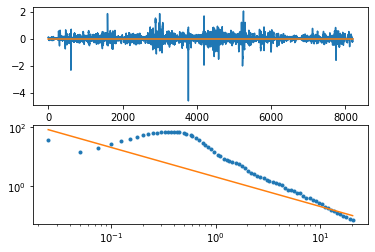

In [ ]:
d = acc_g[:, 0] # imu[:, 5]

print(np.mean(d[:int(1e3)]), np.mean(d[:]), np.mean(d[-int(1e3):]))

fig, ax = plt.subplots(2)
ax[0].plot(d - np.mean(d[:int(1e3)]))
ax[0].plot([0, len(d)], [0,0])

tau, av = allan_variance(d, 1.0/fs, input_type='increment')
ax[1].loglog(tau, av, '.')
params, av_pred = params_from_avar(tau, av)
ax[1].loglog(tau, av_pred)
print(params)

-0.00563595023155737 0.005843174484159926 0.0010269659391802597
quantization    0.000000
white           1.503399
flicker         0.502552
walk            0.000000
ramp            0.000000
Name: 0, dtype: float64


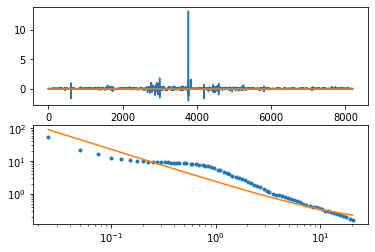

In [ ]:
d = acc_g[:, 1] # imu[:, 5]

print(np.mean(d[:int(1e3)]), np.mean(d[:]), np.mean(d[-int(1e3):]))

fig, ax = plt.subplots(2)
ax[0].plot(d - np.mean(d[:int(1e3)]))
ax[0].plot([0, len(d)], [0,0])

tau, av = allan_variance(d, 1.0/fs, input_type='increment')
ax[1].loglog(tau, av, '.')
params, av_pred = params_from_avar(tau, av)
ax[1].loglog(tau, av_pred)
print(params)

#hmm    